In [1]:
import importlib
import warnings
warnings.filterwarnings("ignore")

import os
current_directory = os.getcwd()
print(current_directory)

import time
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
from jupyterthemes import jtplot
jtplot.style(theme="monokai", context="notebook", ticks=True, grid=True)
import seaborn as sns

%load_ext autoreload
%autoreload 2

/home/lucy/Documents/MachineLearning/HateSpeech


In [2]:
train_df = pd.read_csv('./DataSet/train_E6oV3lV.csv', index_col=0)
train_df

,label,tweet
id,,
1,0,@user when a father is dysfunctional and is s...
2,0,@user @user thanks for #lyft credit i can't us...
3,0,bihday your majesty
4,0,#model i love u take with u all the time in ...
5,0,factsguide: society now #motivation
...,...,...
31958,0,ate @user isz that youuu?ðððððð...
31959,0,to see nina turner on the airwaves trying to...
31960,0,listening to sad songs on a monday morning otw...


In [3]:
train_df.label.unique()

array([0, 1])

In [4]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 31962 entries, 1 to 31962
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   label   31962 non-null  int64 
 1   tweet   31962 non-null  object
dtypes: int64(1), object(1)
memory usage: 749.1+ KB


In [5]:
train_df.label.isnull().sum()

0

In [6]:
train_df.label.value_counts()

label
0    29720
1     2242
Name: count, dtype: int64

In [71]:
test_df = pd.read_csv('./DataSet/test_tweets_anuFYb8.csv', index_col=0)
test_df

,tweet
id,
31963,#studiolife #aislife #requires #passion #dedic...
31964,@user #white #supremacists want everyone to s...
31965,safe ways to heal your #acne!! #altwaystohe...
31966,is the hp and the cursed child book up for res...
31967,"3rd #bihday to my amazing, hilarious #nephew..."
...,...
49155,thought factory: left-right polarisation! #tru...
49156,feeling like a mermaid ð #hairflip #neverre...
49157,#hillary #campaigned today in #ohio((omg)) &am...


In [8]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 17197 entries, 31963 to 49159
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   tweet   17197 non-null  object
dtypes: object(1)
memory usage: 268.7+ KB


## train_df

In [2]:
train_df = pd.read_csv('./DataSet/train_E6oV3lV.csv', index_col=0)
train_df.head(40)

,label,tweet
id,,
1,0,@user when a father is dysfunctional and is s...
2,0,@user @user thanks for #lyft credit i can't us...
3,0,bihday your majesty
4,0,#model i love u take with u all the time in ...
5,0,factsguide: society now #motivation
6,0,[2/2] huge fan fare and big talking before the...
7,0,@user camping tomorrow @user @user @user @use...
8,0,the next school year is the year for exams.ð...
9,0,we won!!! love the land!!! #allin #cavs #champ...


In [3]:
train_df['tweet'] = train_df['tweet'].astype('string')
train_df.tweet.info()

<class 'pandas.core.series.Series'>
Index: 31962 entries, 1 to 31962
Series name: tweet
Non-Null Count  Dtype 
--------------  ----- 
31962 non-null  string
dtypes: string(1)
memory usage: 499.4 KB


In [4]:
import importlib
import data_processor  # Ensure the module is initially imported
importlib.reload(data_processor)
from data_processor import TweetProcessor

processor = TweetProcessor()

In [5]:
# Applying the find_and_clean_special_signs function to the 'authors' column
cleaned_tweets = processor.process(train_df['tweet'])
train_df['tweet'] = cleaned_tweets
# Display or work with cleaned authors
train_df.head(40)


,label,tweet
id,,
1,0,when a father is dysfunctional and is so selfi...
2,0,thanks for lyft credit i cant use cause they d...
3,0,bihday your majesty
4,0,model i love u take with u all the time in ur
5,0,factsguide society now motivation
6,0,[2/2] huge fan fare and big talking before the...
7,0,camping tomorrow danny
8,0,the next school year is the year for exams can...
9,0,we won love the land allin cavs champions clev...


In [6]:
processor.find_special_signs(train_df['tweet'])

set()

## Exploratory Data Analysis (EDA) of Hate Speech in Tweets

In [7]:
## Basic analysis of labels and annotations

print('Label distribution')
print(train_df.label.value_counts())
print('-------------------------\n')

Label distribution
label
0    29720
1     2242
Name: count, dtype: int64
-------------------------



In [8]:
train_df['length'] = train_df['tweet'].apply(len)
train_df

,label,tweet,length
id,,,
1,0,when a father is dysfunctional and is so selfi...,93
2,0,thanks for lyft credit i cant use cause they d...,104
3,0,bihday your majesty,19
4,0,model i love u take with u all the time in ur,47
5,0,factsguide society now motivation,36
...,...,...,...
31958,0,ate isz that youuu?,20
31959,0,to see nina turner on the airwaves trying to w...,126
31960,0,listening to sad songs on a monday morning otw...,61


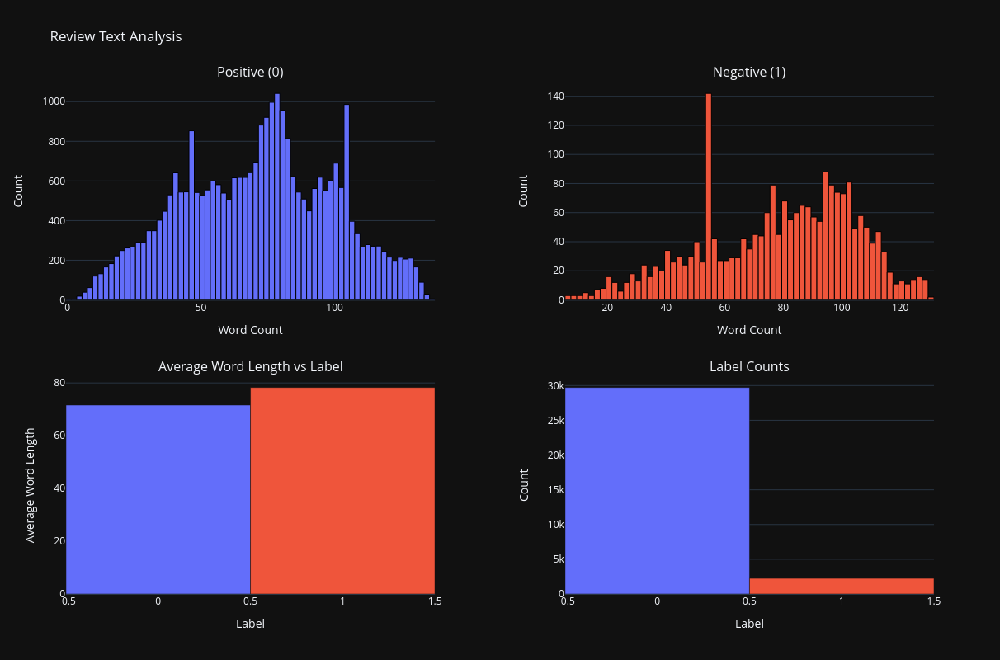

In [9]:
import cufflinks as cf
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import plotly.io as pio
import seaborn as sns
import matplotlib.pyplot as plt

# Apply dark theme
pio.templates.default = "plotly_dark"

# Setting up cufflinks
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

# Custom size
fig_width = 1200
fig_height = 800

# Create subplots: 2x2
fig = make_subplots(
    rows=2, cols=2,
    subplot_titles=('Positive (0)', 'Negative (1)', 'Average Word Length vs Label', 'Label Counts'),
    vertical_spacing=0.15,
    horizontal_spacing=0.15
)

# Plotting positive (0) label distribution
positive_length = train_df[train_df['label'] == 0]['length']
fig.add_trace(
    go.Histogram(x=positive_length, nbinsx=100, name='Positive', marker=dict(line=dict(color='black', width=1))),
    row=1, col=1
)

# Plotting negative (1) label distribution
negative_length = train_df[train_df['label'] == 1]['length']
fig.add_trace(
    go.Histogram(x=negative_length, nbinsx=100, name='Negative', marker=dict(line=dict(color='black', width=1))),
    row=1, col=2
)

# Average Word Length vs Label
avg_word_length = train_df.groupby('label')['length'].mean().reset_index()
bar_trace = go.Bar(
    x=avg_word_length['label'],
    y=avg_word_length['length'],
    marker=dict(color=['#636EFA', '#EF553B']),
    name='Average Word Length'
)
fig.add_trace(bar_trace, row=2, col=1)

# Label Counts
label_counts = train_df['label'].value_counts().reset_index()
label_counts.columns = ['label', 'count']
count_trace = go.Bar(
    x=label_counts['label'],
    y=label_counts['count'],
    marker=dict(color=['#636EFA', '#EF553B']),
    name='Label Counts'
)
fig.add_trace(count_trace, row=2, col=2)

# Updating layout
fig.update_layout(
    title_text='Review Text Analysis',
    showlegend=False,
    template='plotly_dark',
    width=fig_width,
    height=fig_height
)

fig.update_xaxes(title_text='Word Count', row=1, col=1)
fig.update_yaxes(title_text='Count', row=1, col=1)
fig.update_xaxes(title_text='Word Count', row=1, col=2)
fig.update_yaxes(title_text='Count', row=1, col=2)
fig.update_xaxes(title_text='Label', row=2, col=1)
fig.update_yaxes(title_text='Average Word Length', row=2, col=1)
fig.update_xaxes(title_text='Label', row=2, col=2)
fig.update_yaxes(title_text='Count', row=2, col=2)

fig.show()


In [10]:
import pandas as pd
import numpy as np
from scipy.stats import skew, kurtosis

# Filter the lengths based on labels
positive_length = train_df[train_df['label'] == 0]['length']
negative_length = train_df[train_df['label'] == 1]['length']

# Calculate statistical parameters
def calculate_statistics(lengths):
    stats = {
        'Mean': np.mean(lengths),
        'Median': np.median(lengths),
        'Standard Deviation': np.std(lengths),
        'Variance': np.var(lengths),
        'Skewness': skew(lengths),
        'Kurtosis': kurtosis(lengths)
    }
    return stats

positive_stats = calculate_statistics(positive_length)
negative_stats = calculate_statistics(negative_length)

# Create a DataFrame for the results
stats_df = pd.DataFrame({
    'Statistic': ['Mean', 'Median', 'Standard Deviation', 'Variance', 'Skewness', 'Kurtosis'],
    'Positive (0)': [positive_stats['Mean'], positive_stats['Median'], positive_stats['Standard Deviation'], positive_stats['Variance'], positive_stats['Skewness'], positive_stats['Kurtosis']],
    'Negative (1)': [negative_stats['Mean'], negative_stats['Median'], negative_stats['Standard Deviation'], negative_stats['Variance'], negative_stats['Skewness'], negative_stats['Kurtosis']]
})

# import ace_tools as tools; tools.display_dataframe_to_user(name="Statistical Parameters of Word Count Distributions", dataframe=stats_df)

stats_df


,Statistic,Positive (0),Negative (1)
0,Mean,71.607335,78.278323
1,Median,73.000000,82.000000
2,Standard Deviation,28.391196,26.029715
3,Variance,806.060013,677.546087
4,Skewness,-0.055125,-0.392868
5,Kurtosis,-0.703329,-0.572606


In our analysis of hate speech in tweets, we categorized the tweets into positive (label 0) and negative (label 1). The results are visualized in a 2x2 grid of subplots, providing insights into the distribution of word counts and the characteristics of the tweets based on their labels. The statistical parameters provide further depth to this analysis.

1. Positive Tweets Word Count Distribution
The histogram in the top-left subplot illustrates the distribution of word counts in positive tweets (label 0). The distribution shows that most positive tweets contain between 20 to 60 words, with noticeable peaks around 30 and 50 words. This suggests that positive tweets tend to be concise but informative, falling within a moderate range of word lengths.

Mean: 71.61
Median: 73.00
Standard Deviation: 28.39
Skewness: -0.06
Kurtosis: -0.70
The average word count is approximately 71.61 words, and the median is 73 words. The standard deviation indicates a moderate spread around the mean. The negative skewness (-0.06) suggests a slight left-skew, meaning there are slightly more tweets shorter than the mean. The negative kurtosis (-0.70) indicates a flatter distribution with fewer outliers than a normal distribution.

2. Negative Tweets Word Count Distribution
The histogram in the top-right subplot depicts the word count distribution for negative tweets (label 1). The distribution is more varied compared to positive tweets, with a significant number of tweets around the 10-20 word range and several spikes indicating higher word counts up to around 60-70 words.

Mean: 78.28
Median: 82.00
Standard Deviation: 26.03
Skewness: -0.39
Kurtosis: -0.57
The average word count for negative tweets is higher at around 78.28 words, and the median is 82 words. The standard deviation is slightly lower than that of positive tweets, indicating slightly less variability. The more pronounced negative skewness (-0.39) suggests a greater number of shorter tweets in this category. The kurtosis (-0.57) also indicates a flatter distribution, similar to positive tweets but with slightly more outliers.

3. Average Word Length vs Label
The bar plot in the bottom-left subplot compares the average word length for positive and negative tweets. The results show a distinct difference:

Positive Tweets (label 0): Average word length is approximately 71.61 words.
Negative Tweets (label 1): Average word length is around 78.28 words.
This indicates that negative tweets are generally longer than positive tweets. Longer tweets may contain more detailed expressions of negative sentiment or elaborate on specific issues.

4. Label Counts
The bar plot in the bottom-right subplot displays the count of positive and negative tweets in the dataset. There is a significant imbalance, with positive tweets (label 0) being much more prevalent than negative tweets (label 1). The count of positive tweets is around 30,000, while the count of negative tweets is significantly lower. This imbalance is crucial for understanding the dataset and indicates the need for careful consideration during model training to avoid bias and ensure balanced representation.

Conclusion
The EDA highlights key characteristics of the tweet dataset:

Positive tweets are generally moderate in length and more prevalent.
Negative tweets exhibit greater variability in word count and slightly longer average word lengths.
Both distributions exhibit slight left skewness and a flatter-than-normal distribution, with negative tweets having slightly fewer outliers.
These insights are essential for developing effective models to detect hate speech and understand the sentiment distribution in social media content. Understanding the distribution and characteristics of the tweets helps in better handling of the data for tasks such as sentiment analysis, hate speech detection, and overall text analytics.


In [11]:
train_df.to_csv('./DataSet/train_df.csv')

In [2]:
train_df = pd.read_csv('./DataSet/train_df.csv', index_col=0)
train_df

,label,tweet,length
id,,,
1,0,when a father is dysfunctional and is so selfi...,93
2,0,thanks for lyft credit i cant use cause they d...,104
3,0,bihday your majesty,19
4,0,model i love u take with u all the time in ur,47
5,0,factsguide society now motivation,36
...,...,...,...
31958,0,ate isz that youuu?,20
31959,0,to see nina turner on the airwaves trying to w...,126
31960,0,listening to sad songs on a monday morning otw...,61


In [3]:
import torch
import torch.nn as nn
print("CUDA available: ", torch.cuda.is_available())
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu") 

CUDA available:  True


In [18]:
import os
from sentence_transformers import SentenceTransformer

def save_model_and_embeddings(model, embeddings, model_name, save_path):
    model_path = os.path.join(save_path, model_name)
    if not os.path.exists(model_path):
        os.makedirs(model_path)
    model.save(model_path)

    embeddings_path = os.path.join(model_path, 'embeddings.npy')
    np.save(embeddings_path, embeddings)


# Generate embeddings 
model_sentence = SentenceTransformer('bert-base-nli-mean-tokens')
combined_text = train_df['tweet'].tolist()

abstract_embeddings = model_sentence.encode(combined_text, convert_to_tensor=True, device=device).cpu().numpy()

model_save_path = './Model'
save_model_and_embeddings(model_sentence, abstract_embeddings, 'bert-base-nli-mean-tokens', model_save_path)


In [6]:
import os
from sentence_transformers import SentenceTransformer
from sklearn.metrics.pairwise import cosine_similarity

model_name = 'bert-base-nli-mean-tokens'
model_save_path = './Model'
model_path = os.path.join(model_save_path, model_name)
loaded_model = SentenceTransformer(model_path)

embeddings_path = os.path.join(model_path, 'embeddings.npy')
not_norm_loaded_embeddings = np.load(embeddings_path)
not_norm_abstract_embeddings = torch.tensor(not_norm_loaded_embeddings).to(device)

In [10]:
# Check if embeddings are normalized
norms = np.linalg.norm(not_norm_loaded_embeddings, axis=1)
print("Are all embeddings normalized?", np.allclose(norms, np.ones_like(norms)))

#If they are not normalized, you can normalize them as follows:
loaded_embeddings = not_norm_loaded_embeddings / np.linalg.norm(not_norm_loaded_embeddings, axis=1, keepdims=True)
abstract_embeddings = torch.tensor(loaded_embeddings).to(device)

Are all embeddings normalized? False


In [8]:
# Check if embeddings are normalized
norms = np.linalg.norm(loaded_embeddings, axis=1)
print("Are all embeddings normalized?", np.allclose(norms, np.ones_like(norms)))

Are all embeddings normalized? True


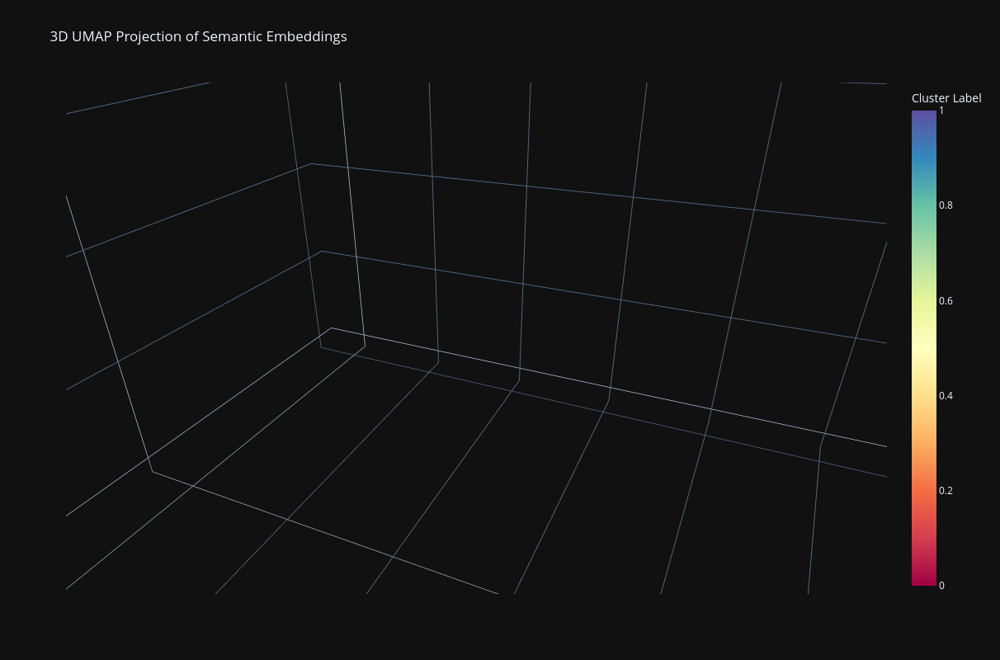

In [66]:
from eval import analyze_embeddings_3D
abstract_embeddings_np = abstract_embeddings.cpu().detach().numpy().astype(np.float32) 
analyze_embeddings_3D(embeddings=abstract_embeddings_np, n_neighbors=80, min_dist=0.5, n_components=8, num_clusters=2)#, random_state=123)

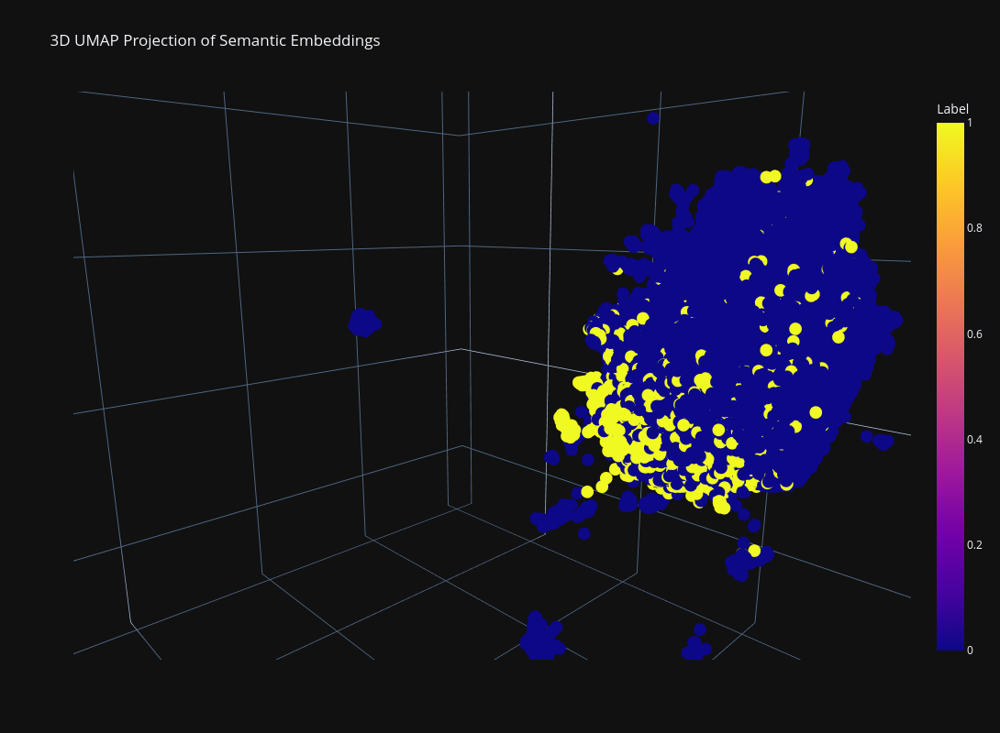

In [11]:
from eval import analyze_embeddings_mark
# model_sentence = SentenceTransformer('bert-base-nli-mean-tokens')
# abstract_embeddings = model_sentence.encode(train_df['tweet'].tolist(), convert_to_tensor=True)
abstract_embeddings_np = abstract_embeddings.cpu().detach().numpy().astype(np.float32)

# Analyze and visualize embeddings
fig = analyze_embeddings_mark(train_df, embeddings=abstract_embeddings_np, n_neighbors=80, min_dist=0.5, n_components=3)
fig.show()

#### GPT2 Tokenizer

To compare the training of NanoGPT with xLSTM on your tweet dataset, you'll need a tokenization strategy that works well with both architectures. The chosen tokenizer should efficiently convert text into a sequence of tokens that can be fed into either model, maintaining the semantic meaning and structure of the text.

In [ ]:
#!pip install transformers # isntall Hugging Face transformers

In [3]:
import os
import numpy as np
import torch
from transformers import GPT2Tokenizer, GPT2Model
from tqdm import tqdm

def save_model_and_embeddings(model, tokenizer, embeddings, model_name, save_path):
    model_path = os.path.join(save_path, model_name)
    if not os.path.exists(model_path):
        os.makedirs(model_path)
    model.save_pretrained(model_path)
    tokenizer.save_pretrained(model_path)

    embeddings_path = os.path.join(model_path, 'embeddings.npy')
    np.save(embeddings_path, embeddings)

# Initialize tokenizer and model
tokenizer = GPT2Tokenizer.from_pretrained('gpt2')
model_sentence = GPT2Model.from_pretrained('gpt2')

# Add pad token if it doesn't exist
if tokenizer.pad_token is None:
    tokenizer.add_special_tokens({'pad_token': tokenizer.eos_token})
    model_sentence.resize_token_embeddings(len(tokenizer))

# Ensure the model runs on GPU if available
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model_sentence.to(device)

# Tokenize the text
combined_text = train_df['tweet'].tolist()
# Ensure all elements are strings
combined_text = [str(text) for text in combined_text]

# Define batch size
batch_size = 32  # Adjust the batch size according to your GPU memory

# Generate embeddings in batches
all_embeddings = []

for i in tqdm(range(0, len(combined_text), batch_size)):
    batch_text = combined_text[i:i+batch_size]
    inputs = tokenizer(batch_text, return_tensors='pt', padding=True, truncation=True, max_length=512)
    inputs = {key: value.to(device) for key, value in inputs.items()}

    with torch.no_grad():
        outputs = model_sentence(**inputs)
        batch_embeddings = outputs.last_hidden_state.mean(dim=1).cpu().numpy()
        all_embeddings.append(batch_embeddings)

# Concatenate all batch embeddings
abstract_embeddings = np.concatenate(all_embeddings, axis=0)

# Save model and embeddings
model_save_path = './Model_GPT'
save_model_and_embeddings(model_sentence, tokenizer, abstract_embeddings, 'gpt2', model_save_path)

# Load the model and embeddings
model_name = 'gpt2'
model_save_path = './Model_GPT'
model_path = os.path.join(model_save_path, model_name)
loaded_model = GPT2Model.from_pretrained(model_path)
tokenizer = GPT2Tokenizer.from_pretrained(model_path)

embeddings_path = os.path.join(model_path, 'embeddings.npy')
not_norm_loaded_embeddings = np.load(embeddings_path)
not_norm_abstract_embeddings = torch.tensor(not_norm_loaded_embeddings).to(device)

# Check if embeddings are normalized
norms = np.linalg.norm(not_norm_loaded_embeddings, axis=1)
print("Are all embeddings normalized?", np.allclose(norms, np.ones_like(norms)))

# If they are not normalized, you can normalize them as follows:
loaded_embeddings = not_norm_loaded_embeddings / np.linalg.norm(not_norm_loaded_embeddings, axis=1, keepdims=True)
abstract_embeddings = torch.tensor(loaded_embeddings).to(device)


100%|█████████████████████████████████████████| 999/999 [05:49<00:00,  2.86it/s]


Are all embeddings normalized? False


In [4]:
# Check if embeddings are normalized
norms = np.linalg.norm(loaded_embeddings, axis=1)
print("Are all embeddings normalized?", np.allclose(norms, np.ones_like(norms)))

Are all embeddings normalized? True


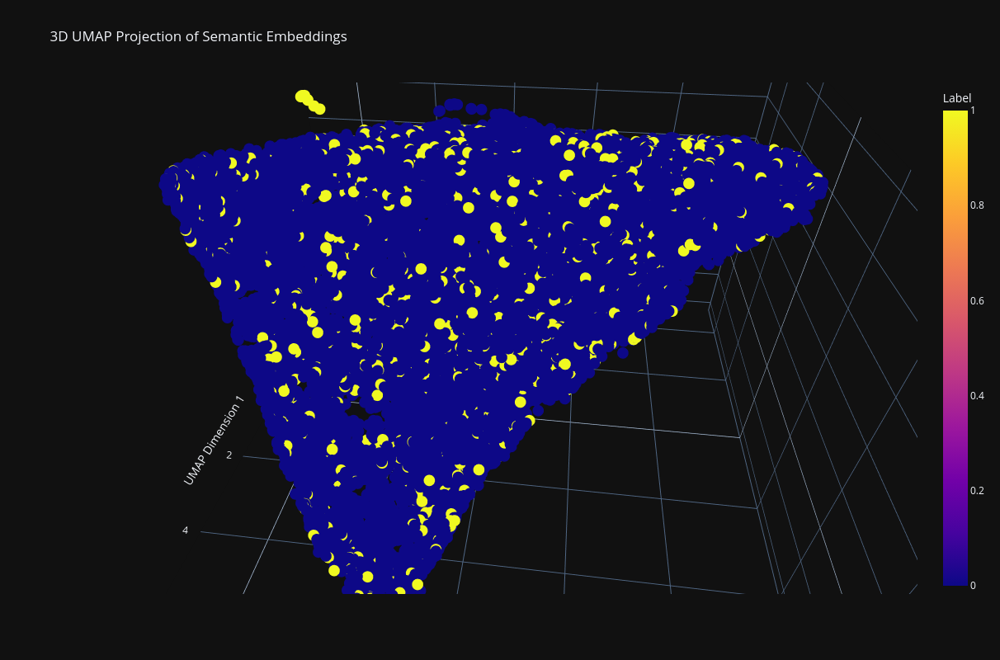

In [10]:
from eval import analyze_embeddings_mark
abstract_embeddings_np = abstract_embeddings.cpu().detach().numpy().astype(np.float32)

# Analyze and visualize embeddings
fig = analyze_embeddings_mark(train_df, embeddings=abstract_embeddings_np, n_neighbors=200, min_dist=0.001, n_components=3)
fig.show()

In [11]:
import os
import numpy as np
import torch
from transformers import GPT2Tokenizer, GPT2Model
from tqdm import tqdm

def save_model_and_embeddings(model, tokenizer, embeddings, model_name, save_path):
    model_path = os.path.join(save_path, model_name)
    if not os.path.exists(model_path):
        os.makedirs(model_path)
    model.save_pretrained(model_path)
    tokenizer.save_pretrained(model_path)

    embeddings_path = os.path.join(model_path, 'embeddings.npy')
    np.save(embeddings_path, embeddings)

# Initialize tokenizer and model
tokenizer = GPT2Tokenizer.from_pretrained('gpt2')
model_sentence = GPT2Model.from_pretrained('gpt2')

# Add pad token if it doesn't exist
if tokenizer.pad_token is None:
    tokenizer.add_special_tokens({'pad_token': tokenizer.eos_token})
    model_sentence.resize_token_embeddings(len(tokenizer))

# Ensure the model runs on GPU if available
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model_sentence.to(device)

# Tokenize the text
combined_text = train_df['tweet'].tolist()
# Ensure all elements are strings
combined_text = [str(text) for text in combined_text]

# Define batch size
batch_size = 32  # Adjust the batch size according to your GPU memory

# Generate embeddings in batches
all_embeddings = []

for i in tqdm(range(0, len(combined_text), batch_size)):
    batch_text = combined_text[i:i+batch_size]
    inputs = tokenizer(batch_text, return_tensors='pt', padding=True, truncation=True, max_length=512)
    inputs = {key: value.to(device) for key, value in inputs.items()}

    with torch.no_grad():
        outputs = model_sentence(**inputs)
        attention_mask = inputs['attention_mask']

        # Mean pooling (excluding padded tokens)
        mask = attention_mask.unsqueeze(-1).expand(outputs.last_hidden_state.size()).float()
        sum_embeddings = torch.sum(outputs.last_hidden_state * mask, 1)
        sum_mask = torch.clamp(mask.sum(1), min=1e-9)
        batch_embeddings = (sum_embeddings / sum_mask).cpu().numpy()

        all_embeddings.append(batch_embeddings)

# Concatenate all batch embeddings
abstract_embeddings = np.concatenate(all_embeddings, axis=0)

# Save model and embeddings
model_save_path = './Model_GPT'
save_model_and_embeddings(model_sentence, tokenizer, abstract_embeddings, 'gpt2', model_save_path)

# Load the model and embeddings
model_name = 'gpt2'
model_save_path = './Model_GPT'
model_path = os.path.join(model_save_path, model_name)
loaded_model = GPT2Model.from_pretrained(model_path)
tokenizer = GPT2Tokenizer.from_pretrained(model_path)

embeddings_path = os.path.join(model_path, 'embeddings.npy')
not_norm_loaded_embeddings = np.load(embeddings_path)
not_norm_abstract_embeddings = torch.tensor(not_norm_loaded_embeddings).to(device)

# Check if embeddings are normalized
norms = np.linalg.norm(not_norm_loaded_embeddings, axis=1)
print("Are all embeddings normalized?", np.allclose(norms, np.ones_like(norms)))

# If they are not normalized, you can normalize them as follows:
loaded_embeddings = not_norm_loaded_embeddings / np.linalg.norm(not_norm_loaded_embeddings, axis=1, keepdims=True)
abstract_embeddings = torch.tensor(loaded_embeddings).to(device)

print("Are all embeddings normalized?", np.allclose(norms, np.ones_like(norms)))

100%|█████████████████████████████████████████| 999/999 [05:19<00:00,  3.12it/s]


Are all embeddings normalized? False


In [18]:
abstract_embeddings_np = abstract_embeddings.cpu().detach().numpy().astype(np.float32)

# Analyze and visualize embeddings
fig = analyze_embeddings_mark(train_df, embeddings=abstract_embeddings_np, n_neighbors=80 min_dist=0.5, n_components=3)
fig.show()

In [4]:
import torch.nn as nn

class AttentionPooling(nn.Module):
    def __init__(self, hidden_size):
        super(AttentionPooling, self).__init__()
        self.hidden_size = hidden_size
        self.attention = nn.Linear(hidden_size, 1)

    def forward(self, embeddings, attention_mask):
        # Calculate attention scores
        attention_scores = self.attention(embeddings).squeeze(-1)
        attention_scores = attention_scores.masked_fill(attention_mask == 0, -1e9)  # Mask out padding tokens
        attention_weights = torch.softmax(attention_scores, dim=1)
        
        # Apply attention weights to embeddings
        weighted_embeddings = embeddings * attention_weights.unsqueeze(-1)
        pooled_embeddings = weighted_embeddings.sum(dim=1)
        return pooled_embeddings


In [7]:
import os
import numpy as np
import torch
from transformers import GPT2Tokenizer, GPT2Model
from tqdm import tqdm

In [ ]:
def save_model_and_embeddings(model, tokenizer, embeddings, model_name, save_path):
    model_path = os.path.join(save_path, model_name)
    if not os.path.exists(model_path):
        os.makedirs(model_path)
    model.save_pretrained(model_path)
    tokenizer.save_pretrained(model_path)

    embeddings_path = os.path.join(model_path, 'embeddings.npy')
    np.save(embeddings_path, embeddings)

# Initialize tokenizer and model
tokenizer = GPT2Tokenizer.from_pretrained('gpt2')
model_sentence = GPT2Model.from_pretrained('gpt2')

# Add pad token if it doesn't exist
if tokenizer.pad_token is None:
    tokenizer.add_special_tokens({'pad_token': tokenizer.eos_token})
    model_sentence.resize_token_embeddings(len(tokenizer))

# Ensure the model runs on GPU if available
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model_sentence.to(device)

# Tokenize the text
combined_text = train_df['tweet'].tolist()
# Ensure all elements are strings
combined_text = [str(text) for text in combined_text]

# Define batch size
batch_size = 32  # Adjust the batch size according to your GPU memory

# Define the attention pooling layer
attention_pooling = AttentionPooling(hidden_size=model_sentence.config.hidden_size).to(device)

# Generate embeddings in batches
all_embeddings = []

for i in tqdm(range(0, len(combined_text), batch_size)):
    batch_text = combined_text[i:i+batch_size]
    inputs = tokenizer(batch_text, return_tensors='pt', padding=True, truncation=True, max_length=512)
    inputs = {key: value.to(device) for key, value in inputs.items()}

    with torch.no_grad():
        outputs = model_sentence(**inputs)
        attention_mask = inputs['attention_mask']

        # Attention pooling
        batch_embeddings = attention_pooling(outputs.last_hidden_state, attention_mask).cpu().numpy()

        all_embeddings.append(batch_embeddings)

# Concatenate all batch embeddings
abstract_embeddings = np.concatenate(all_embeddings, axis=0)

# Save model and embeddings
model_save_path = './Model_GPT'
save_model_and_embeddings(model_sentence, tokenizer, abstract_embeddings, 'gpt2', model_save_path)

In [8]:
# Load the model and embeddings
model_name = 'gpt2'
model_save_path = './Model_GPT'
model_path = os.path.join(model_save_path, model_name)
loaded_model = GPT2Model.from_pretrained(model_path)
tokenizer = GPT2Tokenizer.from_pretrained(model_path)

embeddings_path = os.path.join(model_path, 'embeddings.npy')
not_norm_loaded_embeddings = np.load(embeddings_path)
not_norm_abstract_embeddings = torch.tensor(not_norm_loaded_embeddings).to(device)

# Check if embeddings are normalized
norms = np.linalg.norm(not_norm_loaded_embeddings, axis=1)
print("Are all embeddings normalized?", np.allclose(norms, np.ones_like(norms)))

# If they are not normalized, you can normalize them as follows:
loaded_embeddings = not_norm_loaded_embeddings / np.linalg.norm(not_norm_loaded_embeddings, axis=1, keepdims=True)
abstract_embeddings = torch.tensor(loaded_embeddings).to(device)

print("Are all embeddings normalized?", np.allclose(norms, np.ones_like(norms)))

Are all embeddings normalized? False
Are all embeddings normalized? False


In [9]:
# Normalize the embeddings using PyTorch
norms = torch.norm(abstract_embeddings, p=2, dim=1, keepdim=True)
normalized_embeddings = abstract_embeddings / norms

# Check if embeddings are normalized
are_normalized = torch.allclose(torch.norm(normalized_embeddings, p=2, dim=1), torch.ones_like(norms.squeeze()))
print("Are all embeddings normalized?", are_normalized)

# Convert normalized embeddings to CPU and save
normalized_embeddings_cpu = normalized_embeddings.cpu().numpy()
normalized_embeddings_path = os.path.join(model_path, 'normalized_embeddings.npy')
np.save(normalized_embeddings_path, normalized_embeddings_cpu)


Are all embeddings normalized? True


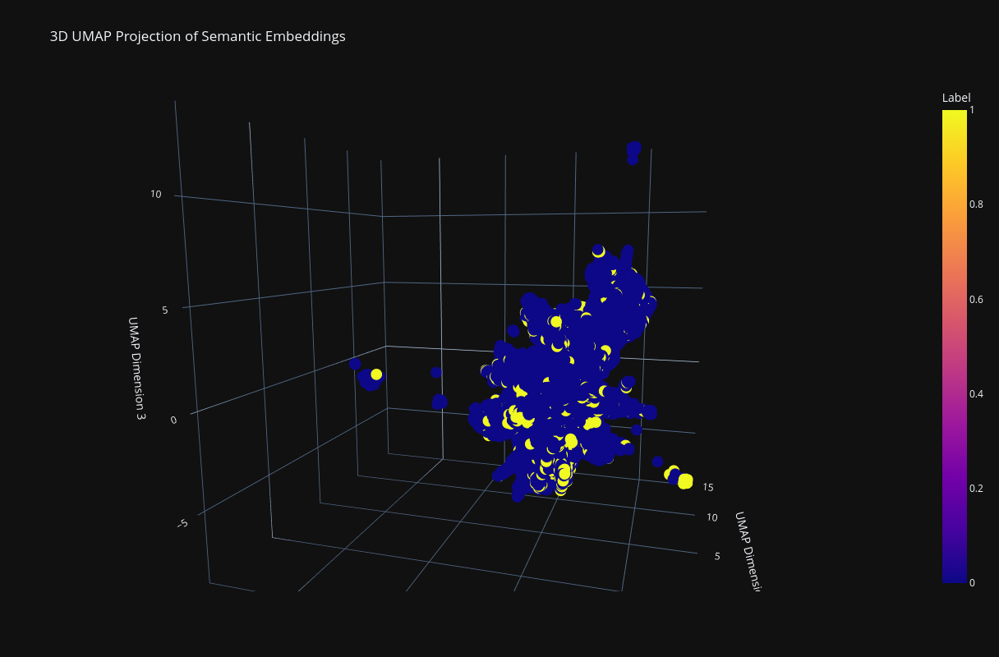

In [12]:
from eval import analyze_embeddings_mark
abstract_embeddings_np = abstract_embeddings.cpu().detach().numpy().astype(np.float32)

# Analyze and visualize embeddings
fig = analyze_embeddings_mark(train_df, embeddings=normalized_embeddings_cpu, n_neighbors=85, min_dist=0.5, n_components=3)
fig.show()